# Effects of Different Material Properties on Point Cloud Intensity Values and Geometric Properties

Notebook: Hannah Weiser, 2023

This notebook demonstrates the effects of different material properties on point cloud intensity values and on point cloud geometry.

We will use the command-line access of HELIOS++ to run the simulation, and use Python for displaying the input files and the resulting point clouds.


In [1]:
import sys, os
from pathlib import Path
from IPython.display import Code
import open3d as o3d
from open3d.web_visualizer import draw

current_folder = globals()['_dh'][0]
helios_path = str(Path(current_folder).parent)
sys.path.append(helios_path)  # add helios-plusplus directory to PATH
import pyhelios

from pyhelios.util.xmldisplayer import display_xml, find_playback_dir

os.chdir(helios_path)

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.
[Open3D INFO] Resetting default logger to print to terminal.


## Scene

To compare different material properties, we are creating four scenes (`_v0`, `_v1`, `_v2` and `_v3`).

Each scene has the following objects:
- Terrain (`asphalt`)
- Tree (`sassafras_low`)
- Grass below the tree (`grass`)
- Building (`Building1254`)

In [2]:
Code(display_xml('data/scenes/intensity/intensity_scene_v1.xml'), language='XML')

<document>
        <scene id="intensity_scene" name="intensity_scene">
            <part>
                <filter type="objloader">
                    <param type="string" key="filepath" value="data/sceneparts/intensity_scene/asphalt_v1.obj" />
                    <param type="string" key="up" value="z" />
                </filter>
                <filter type="translate">
                    <param type="vec3" key="offset" value="0.0;0.0;0.0" />
                </filter>
                <filter type="scale">
                    <param type="double" key="scale" value="25.0" />
                </filter>
            </part>
            <part>
                <filter type="objloader">
                    <param type="string" key="filepath" value="data/sceneparts/intensity_scene/grass_v1.obj" />
                    <param type="string" key="up" value="z" />
                </filter>
                <filter type="translate">
                    <param type="vec3" key="offset" value="-10.0;-10.0;0.02" />
                </filter>
                <filter type="scale">
                    <param type="double" key="scale" value="5.0" />
                </filter>
            </part>
            <part>
                <filter type="objloader">
                    <param type="string" key="filepath" value="data/sceneparts/intensity_scene/sassafras_low_v1.obj" />
                    <param type="string" key="up" value="z" />
                </filter>

                <filter type="translate">
                    <param type="vec3" key="offset" value="-10.0;-10.0;0.0" />
                </filter>
                <filter type="scale">
                    <param type="double" key="scale" value="1.0" />
                </filter>
            </part>
            <part>
                <filter type="objloader">
                    <param type="string" key="filepath" value="data/sceneparts/intensity_scene/Building1254_v1.obj" />
                    <param type="string" key="up" value="z" />
                </filter>

                <filter type="translate">
                    <param type="vec3" key="offset" value="-5.0;-10.0;0.0" />
                </filter>
                <filter type="scale">
                    <param type="double" key="scale" value="1.0" />
                </filter>
            </part>
        </scene>
    </document>

Let's display the geometry in 3D:

In [3]:
import plotly.graph_objects as go
import numpy as np

In [4]:
mesh_asphalt = o3d.io.read_triangle_mesh('data/sceneparts/intensity_scene/asphalt_v3.obj')
mesh_asphalt.scale(25, center=mesh_asphalt.get_center())
mesh_sassafras = o3d.io.read_triangle_mesh('data/sceneparts/intensity_scene/sassafras_low_v3.obj')
mesh_sassafras.translate((-10.0, -10.0, 0.0))
mesh_grass = o3d.io.read_triangle_mesh('data/sceneparts/intensity_scene/grass_v3.obj')
mesh_grass.translate((-10.0, -10.0, 0.02))
mesh_grass.scale(5, center=mesh_grass.get_center())
mesh_building = o3d.io.read_triangle_mesh('data/sceneparts/intensity_scene/Building1254_v3.obj')
mesh_building.translate((-5.0, -10.0, 0.0))

TriangleMesh with 80 points and 62 triangles.

In [5]:
fig = go.Figure()
objects = [mesh_asphalt, mesh_grass, mesh_sassafras, mesh_building]
obj_colors = ['black', 'yellowgreen', 'forestgreen', 'lightgrey']
for mesh, c in zip(objects, obj_colors):
    mesh.compute_vertex_normals()
    mesh.compute_triangle_normals()
    triangles = np.asarray(mesh.triangles)
    vertices = np.asarray(mesh.vertices)
    fig.add_trace(
        go.Mesh3d(
            x=vertices[:,0],
            y=vertices[:,1],
            z=vertices[:,2],
            i=triangles[:,0],
            j=triangles[:,1],
            k=triangles[:,2],
            color=c,
            opacity=0.7)
    )
fig.show()

Four versions of this scene are created, which only differ in the material properties that are assigned to the objects. Let's have a look at one of the material files.

In [6]:
with open(Path('data/sceneparts/intensity_scene/sassafras_low.mtl')) as f:
    print(f.read())

newmtl leaves_v0

newmtl leaves_v1
helios_spectra deciduous

newmtl leaves_v2
Kd 0.028654 0.393112 0.018327
Ks 0.000000 0.000000 0.000000
helios_spectra deciduous

newmtl leaves_v3
Ns 250.000000
Kd 0.028654 0.393112 0.018327
Ks 0.400000 0.400000 0.400000
helios_spectra deciduous

newmtl trunk_stem_v0

newmtl trunk_stem_v1
Ka 1.000000 1.000000 1.000000
helios_spectra wood

newmtl trunk_stem_v2
Kd 0.157434 0.066115 0.017540
Ks 0.000000 0.000000 0.000000
helios_spectra wood

newmtl trunk_stem_v3
Ns 29.070042
Kd 0.157434 0.066115 0.017540
Ks 0.100000 0.100000 0.100000
helios_spectra wood



The following gives an overview over the material specification versions and how HELIOS++ intensity is calculated as a result:

**Version 0**: 
- Nothing specified
- Uses a uniform model (anisotropic/direction-independent) with the reflectance $\rho$ = 0.5 (HELIOS++ default reflectance)

**Version 1**: 
- Only `helios_spectra` specified
- Uses a uniform model (anisotropic/direction-independent) with the reflectance as defined for the respective waveform in the look-up table of the spectra, see [`assets/spectra`](https://github.com/3dgeo-heidelberg/helios/tree/dev/assets/spectra)

**Version 2**:
- `Ks` is (0, 0, 0), `Kd` is set to anything
- Uses the Lambertian model, i.e., just use the diffuse reflectance with $BDRF_{r} = cos(\varphi) \cdot \rho$
- where $\varphi$ is the incidence angle reduced by $\pi / 2$ if $\varphi > \pi / 2$, as calculated from the intersection of the ray and the object.

**Version 3**:
- `Ks` is set to > 0, `Kd` is set to anything
- Use the Phong BDRF model, using `Ks`, `Ns` and `Kd` and the reflectance $\rho$

$$BDRF_{r} = \rho * BDRF(\varphi, spec, Ns)$$

where $BDRF$ is defined as 
$$BDRF = (1 - spec) \cdot cos(\varphi) + spec \cdot (|(cos(\varphi *)|)^{Ns}$$

and $spec$ as
$$spec = (k_s[0] + k_s[1] + k_s[2])  / (k_d[0] + k_d[1] + k_d[2] + k_s[0] + k_s[1] + k_s[2])$$

## Surveys

For all scenes, we will perform a simple ULS and TLS survey. The survey files are shown below.

In [7]:
Code(display_xml('data/surveys/intensity/uls_intensity_v1.xml'), language='XML')

<document>
	<scannerSettings id="template1" pulseFreq_hz="100000" active="true" scanFreq_hz="100" scanAngle_deg="50" trajectoryTimeInterval_s="0.05" />
    <survey name="uls_intensity_v1" scene="data/scenes/intensity/intensity_scene_v1.xml#intensity_scene" platform="data/platforms.xml#copter_linearpath" scanner="data/scanners_als.xml#riegl_vux-1uav">
		<leg>
            <platformSettings x="40" y="-40" z="50" movePerSec_m="5" />
            <scannerSettings template="template1" />
        </leg>

        <leg>
            <platformSettings x="40" y="40" z="50" movePerSec_m="5" />
            <scannerSettings template="template1" />
        </leg>

        <leg>
            <platformSettings x="-40" y="40" z="50" movePerSec_m="5" />
            <scannerSettings template="template1" />
        </leg>

        <leg>
            <platformSettings x="-40" y="-40" z="50" movePerSec_m="5" />
            <scannerSettings template="template1" />
        </leg>
        
        <leg>
            <platformSettings x="40" y="40" z="50" />
            <scannerSettings template="template1" active="false" />
        </leg>
    </survey>
</document>

In [8]:
Code(display_xml('data/surveys/intensity/tls_intensity_v1.xml'), language='XML')

<document>
	<scannerSettings id="template1" pulseFreq_hz="300000" active="true" verticalResolution_deg="0.04" horizontalResolution_deg="0.04" />
    <survey name="tls_intensity_v1" scene="data/scenes/intensity/intensity_scene_v1.xml#intensity_scene" platform="data/platforms.xml#tripod" scanner="data/scanners_tls.xml#riegl_vz400">
		<leg>
            <platformSettings x="20" y="-20" z="0" />
            <scannerSettings template="template1" headRotateStart_deg="0" headRotateStop_deg="100" />
        </leg>

    </survey>
</document>

## Running the Simulations

Let's run the simulations.

In [9]:
!"run/helios.exe" "data/surveys/intensity/uls_intensity_v0.xml" "--lasOutput" "--zipOutput" "--rebuildScene" "-q"
!"run/helios.exe" "data/surveys/intensity/uls_intensity_v1.xml" "--lasOutput" "--zipOutput" "--rebuildScene" "-q"
!"run/helios.exe" "data/surveys/intensity/uls_intensity_v2.xml" "--lasOutput" "--zipOutput" "--rebuildScene" "-q"
!"run/helios.exe" "data/surveys/intensity/uls_intensity_v3.xml" "--lasOutput" "--zipOutput" "--rebuildScene" "-q"
!"run/helios.exe" "data/surveys/intensity/tls_intensity_v0.xml" "--lasOutput" "--zipOutput" "--rebuildScene" "-q"
!"run/helios.exe" "data/surveys/intensity/tls_intensity_v1.xml" "--lasOutput" "--zipOutput" "--rebuildScene" "-q"
!"run/helios.exe" "data/surveys/intensity/tls_intensity_v2.xml" "--lasOutput" "--zipOutput" "--rebuildScene" "-q"
!"run/helios.exe" "data/surveys/intensity/tls_intensity_v3.xml" "--lasOutput" "--zipOutput" "--rebuildScene" "-q"

## Loading (and Merging) the Point Clouds

In [10]:
import laspy

In [11]:
survey_fnames = ['uls_intensity_v0.xml', 'uls_intensity_v1.xml', 'uls_intensity_v2.xml', 'uls_intensity_v3.xml',
                 'tls_intensity_v0.xml', 'tls_intensity_v1.xml', 'tls_intensity_v2.xml', 'tls_intensity_v3.xml']

In [12]:
def read_strip(path):
    las = laspy.read(path)
    pc = np.array([las.x, las.y, las.z]).T
    amplitude = las['heliosAmplitude']
    object_id = las['hitObjectId']
    
    return pc, amplitude, object_id

In [13]:
data = {}
for survey in survey_fnames[:4]:
    output_path = find_playback_dir(f'data/surveys/intensity/{survey}')
    print('Loading points from', Path(output_path).relative_to(helios_path).as_posix())
    pc_1, amplitude_1, object_id_1 = read_strip(Path(output_path) / 'leg000_points.laz')
    pc_2, amplitude_2, object_id_2 = read_strip(Path(output_path) / 'leg001_points.laz')
    pc_3, amplitude_3, object_id_3 = read_strip(Path(output_path) / 'leg002_points.laz')
    pc_4, amplitude_4, object_id_4 = read_strip(Path(output_path) / 'leg003_points.laz')
    pc = np.vstack((pc_1, pc_2, pc_3, pc_4))
    amplitude = np.hstack((amplitude_1, amplitude_2, amplitude_3, amplitude_4))
    object_id = np.hstack((object_id_1, object_id_2, object_id_3, object_id_4))
    data[survey] = (pc, amplitude, object_id)
for survey in survey_fnames[4:]:
    output_path = find_playback_dir(f'data/surveys/intensity/{survey}')
    print('Loading points from', Path(output_path).relative_to(helios_path).as_posix())
    pc, amplitude, object_id = read_strip(Path(output_path) / 'leg000_points.laz')
    data[survey] = (pc, amplitude, object_id)

Loading points from output/uls_intensity_v0/2023-08-04_15-33-23
Loading points from output/uls_intensity_v1/2023-08-04_15-33-32
Loading points from output/uls_intensity_v2/2023-08-04_15-33-41
Loading points from output/uls_intensity_v3/2023-08-04_15-33-51
Loading points from output/tls_intensity_v0/2023-08-04_15-34-00
Loading points from output/tls_intensity_v1/2023-08-04_15-34-17
Loading points from output/tls_intensity_v2/2023-08-04_15-34-36
Loading points from output/tls_intensity_v3/2023-08-04_15-34-59


## Visualization

### Part 1: ULS comparison

In [14]:
import matplotlib.pyplot as plt
import matplotlib as mpl

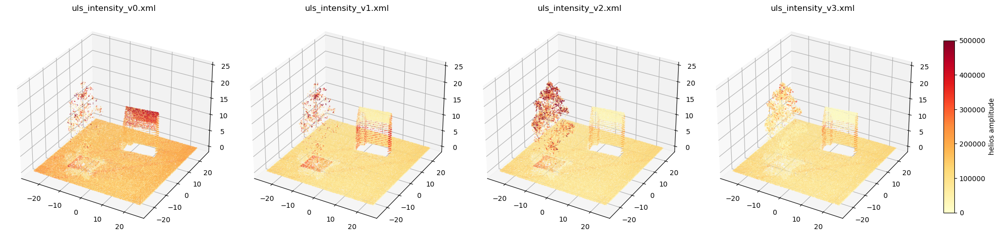

In [15]:
cmap = 'YlOrRd'
norm = mpl.colors.Normalize(vmin=0, vmax=500000)
#norm = mpl.colors.LogNorm(vmax=1000000)
# Matplotlib figure
fig = plt.figure(figsize=(22, 6))
box = (np.ptp(data[survey_fnames[0]][0][:, 0]),
       np.ptp(data[survey_fnames[0]][0][:, 1]),
       np.ptp(data[survey_fnames[0]][0][:, 2]))

box = None
for idx in range(4):
    pc, amp, _ = data[survey_fnames[idx]]
    ax = fig.add_subplot(1,4,idx+1, projection='3d', computed_zorder=False)
    sc = ax.scatter(pc[::5, 0],
                    pc[::5, 1],
                    pc[::5, 2],
                    c=amp[::5],
                    cmap=cmap,
                    norm=norm,
                    s=0.05, zorder=1)
    ax.set_title(survey_fnames[idx])
    ax.set_box_aspect(box)

# Adjust subplots
fig.subplots_adjust(bottom=0.05, top=0.95, left=0.02, right=0.86,
                    wspace=0.07, hspace=0.07)
# Add color bar and set ticks and tick labels
cb_ax = fig.add_axes([0.88, 0.2, 0.01, 0.58])
cbar = fig.colorbar(sc, cax=cb_ax)
cbar.ax.set_ylabel('helios amplitude');

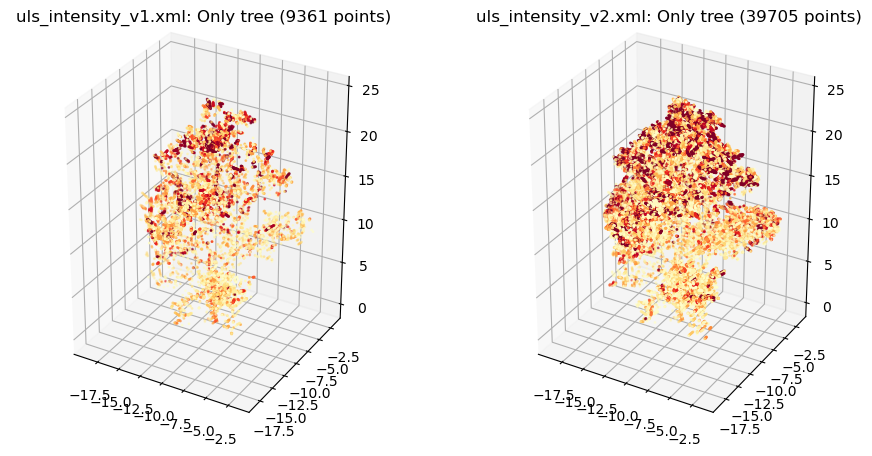

In [16]:
fig = plt.figure(figsize=(11, 6))

pc, amp, oid = data[survey_fnames[1]]
idx_tree = oid == 2
pc_tree = pc[idx_tree]
amp_tree = amp[idx_tree]
ax1 = fig.add_subplot(1,2,1, projection='3d', computed_zorder=False)
sc1 = ax1.scatter(pc_tree[:, 0],
                  pc_tree[:, 1],
                  pc_tree[:, 2],
                  c=amp_tree,
                  cmap=cmap,
                  norm=norm,
                  s=1, zorder=1)
ax1.set_box_aspect((np.ptp(pc_tree[:, 0]),
                    np.ptp(pc_tree[:, 1]),
                    np.ptp(pc_tree[:, 2])))
ax1.set_title(f'{survey_fnames[1]}: Only tree ({pc_tree.shape[0]} points)')
ax2 = fig.add_subplot(1,2,2, projection='3d', computed_zorder=False)
pc, amp, oid = data[survey_fnames[2]]
idx_tree = oid == 2
pc_tree = pc[idx_tree]
amp_tree = amp[idx_tree]
sc2 = ax2.scatter(pc_tree[:, 0],
                  pc_tree[:, 1],
                  pc_tree[:, 2],
                  c=amp_tree,
                  cmap=cmap,
                  norm=norm,
                  s=1, zorder=1)
ax2.set_box_aspect((np.ptp(pc_tree[:, 0]),
                    np.ptp(pc_tree[:, 1]),
                    np.ptp(pc_tree[:, 2])))
ax2.set_title(f'{survey_fnames[2]}: Only tree ({pc_tree.shape[0]} points)');

### Part 2: TLS comparison

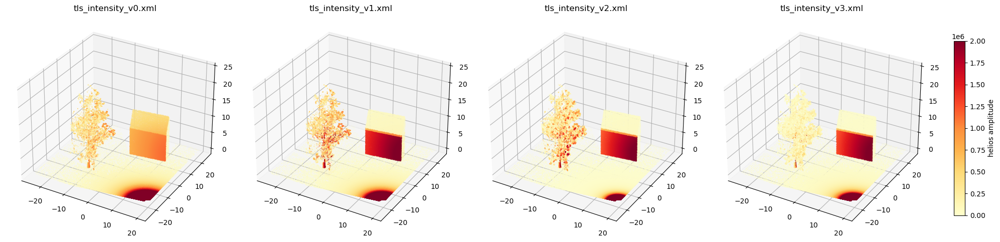

In [17]:
norm = mpl.colors.Normalize(vmin=0, vmax=2000000)
#norm = mpl.colors.LogNorm(vmax=1000000)
# Matplotlib figure
fig = plt.figure(figsize=(22, 6))
box = (np.ptp(data[survey_fnames[0]][0][:, 0]),
       np.ptp(data[survey_fnames[0]][0][:, 1]),
       np.ptp(data[survey_fnames[0]][0][:, 2]))

box = None
for idx in range(4, 8):
    pc, amp, _ = data[survey_fnames[idx]]
    ax = fig.add_subplot(1,4,idx-3, projection='3d', computed_zorder=False)
    sc = ax.scatter(pc[::10, 0],
                    pc[::10, 1],
                    pc[::10, 2],
                    c=amp[::10],
                    cmap=cmap,
                    norm=norm,
                    s=0.05, zorder=1)
    ax.set_title(survey_fnames[idx])
    ax.set_box_aspect(box)

# Adjust subplots
fig.subplots_adjust(bottom=0.05, top=0.95, left=0.02, right=0.86,
                    wspace=0.07, hspace=0.07)
# Add color bar and set ticks and tick labels
cb_ax = fig.add_axes([0.88, 0.2, 0.01, 0.58])
cbar = fig.colorbar(sc, cax=cb_ax)
cbar.ax.set_ylabel('helios amplitude');

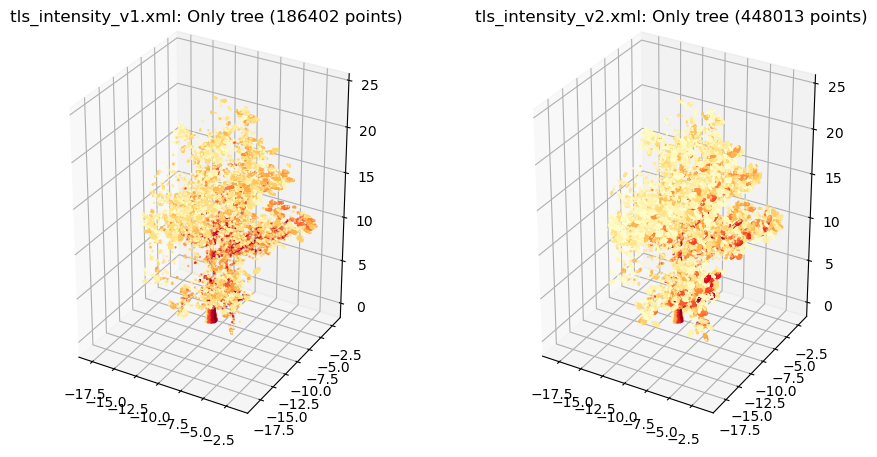

In [18]:
fig = plt.figure(figsize=(11, 6))

pc, amp, oid = data[survey_fnames[5]]
idx_tree = oid == 2
pc_tree = pc[idx_tree]
amp_tree = amp[idx_tree]
ax1 = fig.add_subplot(1,2,1, projection='3d', computed_zorder=False)
sc1 = ax1.scatter(pc_tree[::5, 0],
                  pc_tree[::5, 1],
                  pc_tree[::5, 2],
                  c=amp_tree[::5],
                  cmap=cmap,
                  norm=norm,
                  s=0.5, zorder=1)
ax1.set_box_aspect((np.ptp(pc_tree[:, 0]),
                    np.ptp(pc_tree[:, 1]),
                    np.ptp(pc_tree[:, 2])))
ax1.set_title(f'{survey_fnames[5]}: Only tree ({pc_tree.shape[0]} points)')

ax2 = fig.add_subplot(1,2,2, projection='3d', computed_zorder=False)
pc, amp, oid = data[survey_fnames[6]]
idx_tree = oid == 2
pc_tree = pc[idx_tree]
amp_tree = amp[idx_tree]
sc2 = ax2.scatter(pc_tree[::5, 0],
                  pc_tree[::5, 1],
                  pc_tree[::5, 2],
                  c=amp_tree[::5],
                  cmap=cmap,
                  norm=norm,
                  s=0.5, zorder=1)
ax2.set_box_aspect((np.ptp(pc_tree[:, 0]),
                    np.ptp(pc_tree[:, 1]),
                    np.ptp(pc_tree[:, 2])))
ax2.set_title(f'{survey_fnames[6]}: Only tree ({pc_tree.shape[0]} points)');